<a href="https://colab.research.google.com/github/Laksh718/Answer-arena-game/blob/main/VaxMap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [7]:
!pip install geopandas folium xgboost scikit-learn shapely scipy matplotlib --quiet


In [8]:
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import HeatMap
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from xgboost import XGBClassifier
from scipy.spatial import cKDTree
import matplotlib.pyplot as plt
from IPython.display import display, HTML

pd.set_option('display.max_rows', 50)


In [9]:
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import HeatMap
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from xgboost import XGBClassifier
from scipy.spatial import cKDTree
import matplotlib.pyplot as plt
from IPython.display import display, HTML

pd.set_option('display.max_rows', 50)


In [15]:
# load boundary + ADM4 regions
india = gpd.read_file(
    "/content/drive/MyDrive/GIS/india_India_Country_Boundary.geojson"
).to_crs(4326)

regions = gpd.read_file(
    "/content/drive/MyDrive/GIS/geoBoundaries-IND-ADM4_simplified.geojson"
).to_crs(4326)

print("India Boundary:", len(india))
print("ADM4 Regions:", len(regions))   # ~7143 expected


India Boundary: 1
ADM4 Regions: 7143


In [16]:
# project → compute centroid → back to WGS84
regions_proj = regions.to_crs(3857)
centroids = regions_proj.centroid.to_crs(4326)

regions["Latitude"] = centroids.y
regions["Longitude"] = centroids.x
# simulate coverage distribution
regions["Coverage"] = np.clip(
    np.random.normal(82, 6, len(regions)),
    60, 100
)

# binary risk flag
regions["Risk"] = (regions["Coverage"] < 75).astype(int)

print("Low Coverage Regions:", regions["Risk"].sum())
# poverty inversely correlated with coverage
regions["PovertyIndex"] = np.clip(
    1 - regions["Coverage"]/100 + np.random.normal(0, 0.05, len(regions)),
    0, 1
)

# literacy correlated with coverage
regions["LiteracyRate"] = np.clip(
    regions["Coverage"] + np.random.normal(0, 3, len(regions)),
    40, 100
)

# rural / urban flag
regions["Rurality"] = np.random.choice([0, 1], len(regions))


Low Coverage Regions: 893


In [17]:
X = regions[["PovertyIndex", "LiteracyRate", "Rurality"]]
y = regions["Risk"]

# stratified split
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

# imbalance handling
ratio = (len(y) - y.sum()) / y.sum()
model = XGBClassifier(
    n_estimators=120,
    max_depth=5,
    learning_rate=0.08,
    scale_pos_weight=ratio,
    eval_metric="logloss"
)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)


Accuracy: 0.900629811056683


,precision,recall,f1-score,support
0,0.984266,0.900800,0.940685,1250.00000
1,0.564912,0.899441,0.693966,179.00000
accuracy,0.900630,0.900630,0.900630,0.90063
macro avg,0.774589,0.900121,0.817325,1429.00000
weighted avg,0.931737,0.900630,0.909780,1429.00000


Confusion Matrix:
 [[1126  124]
 [  18  161]]


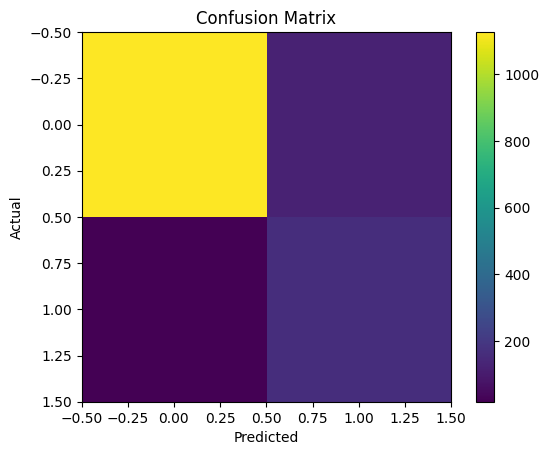

In [19]:
acc = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, output_dict=True, zero_division=0)
cm = confusion_matrix(y_test, y_pred)

print("Accuracy:", acc)
display(pd.DataFrame(report).transpose())
print("Confusion Matrix:\n", cm)
# visual confusion matrix
plt.imshow(cm)
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.colorbar()
plt.show()



In [20]:
# cluster only risky regions
low_cov = regions[regions["Risk"] == 1].copy()

if len(low_cov) > 0:
    coords_scaled = StandardScaler().fit_transform(
        low_cov[["Latitude", "Longitude"]]
    )

    dbscan = DBSCAN(eps=0.3, min_samples=6)
    low_cov["Cluster"] = dbscan.fit_predict(coords_scaled)

    regions = regions.merge(
        low_cov[["shapeName", "Cluster"]],
        on="shapeName",
        how="left"
    )

regions["Cluster"] = regions["Cluster"].fillna(-1)

print("Clusters Found:", set(regions["Cluster"]))
# generate centers across India bounds
centers = pd.DataFrame({
    "Latitude": np.random.uniform(8, 35, 20),
    "Longitude": np.random.uniform(68, 97, 20),
    "Active": np.random.choice([0,1], 20, p=[0.2, 0.8])
})

tree = cKDTree(centers[["Latitude", "Longitude"]])

def nearest_center(lat, lon):
    dist, idx = tree.query([lat, lon])
    return centers.iloc[idx]

display(centers)

table_df = regions[[
    "shapeName","Latitude","Longitude","Coverage",
    "Risk","PovertyIndex","LiteracyRate","Rurality","Cluster"
]].round({
    "Latitude": 6,
    "Longitude": 6,
    "Coverage": 2,
    "PovertyIndex": 3,
    "LiteracyRate": 2
})

display(table_df.head(20))
print(f"Showing 20 of {len(table_df)} rows")



Clusters Found: {0.0, -1.0}


,Latitude,Longitude,Active
0,16.441120,96.390795,0
1,34.627220,79.496823,0
2,10.805828,78.510071,0
3,14.086879,69.858895,1
4,27.232211,74.391338,0
5,24.294780,70.847343,1
6,13.344227,68.245174,0
7,18.296420,70.131127,1
8,31.238753,85.696505,0
9,30.125744,75.498176,1


,shapeName,Latitude,Longitude,Coverage,Risk,PovertyIndex,LiteracyRate,Rurality,Cluster
0,Pratappur,23.535849,83.109415,88.08,0,0.147,83.98,1,-1.0
1,Pali,22.419377,82.343170,85.96,0,0.124,84.50,0,-1.0
2,Lailunga,22.354272,83.592371,85.91,0,0.156,83.95,1,-1.0
3,Bilaigarh,21.615691,82.801042,85.26,0,0.127,83.00,0,-1.0
4,Dharamjaigarh,22.465222,83.235396,81.27,0,0.281,77.39,1,-1.0
5,Balrampur,23.560771,83.550149,82.96,0,0.157,88.22,0,-1.0
6,Wadrafnagar,23.780995,83.118763,76.86,0,0.247,72.09,0,-1.0
7,Gharghoda,22.231306,83.334304,77.19,0,0.263,76.38,1,-1.0
8,Kota,22.419567,82.031220,93.46,0,0.109,93.65,0,-1.0
9,Dantewada,18.802973,81.343186,86.01,0,0.122,84.52,1,-1.0


Showing 20 of 7455 rows


In [21]:
# expandable full table
display(HTML("""
<button onclick="
var x=document.getElementById('fulltbl');
if(x.style.display==='none'){x.style.display='block'}
else{x.style.display='none'}">
Toggle Full Dataset
</button>
"""))

display(HTML('<div id="fulltbl" style="display:none">'))
display(table_df)
display(HTML('</div>'))


,shapeName,Latitude,Longitude,Coverage,Risk,PovertyIndex,LiteracyRate,Rurality,Cluster
0,Pratappur,23.535849,83.109415,88.08,0,0.147,83.98,1,-1.0
1,Pali,22.419377,82.343170,85.96,0,0.124,84.50,0,-1.0
2,Lailunga,22.354272,83.592371,85.91,0,0.156,83.95,1,-1.0
3,Bilaigarh,21.615691,82.801042,85.26,0,0.127,83.00,0,-1.0
4,Dharamjaigarh,22.465222,83.235396,81.27,0,0.281,77.39,1,-1.0
...,...,...,...,...,...,...,...,...,...
7450,Alwal,17.526263,78.517223,83.23,0,0.237,82.55,0,-1.0
7451,Balanagar,17.469872,78.461673,86.06,0,0.124,86.19,1,-1.0
7452,Kukatpally,17.485988,78.411229,78.25,0,0.238,76.68,0,-1.0
7453,Warangal,18.010254,79.623375,86.33,0,0.147,86.77,0,-1.0


In [23]:
# smoother rendering
viz_regions = regions.sample(2500, random_state=42).copy()
viz_json = viz_regions.to_json()

m = folium.Map(location=[22.5, 80.9], zoom_start=5, tiles="cartodbpositron")

# India boundary
folium.GeoJson(
    india,
    name="India Boundary",
    style_function=lambda x: {
        "fillOpacity": 0,
        "color": "black",
        "weight": 2
    }
).add_to(m)

# Coverage choropleth
folium.Choropleth(
    geo_data=viz_json,
    data=viz_regions,
    columns=["shapeName", "Coverage"],
    key_on="feature.properties.shapeName",
    fill_color="YlOrRd",
    fill_opacity=0.75,
    line_opacity=0.2,
    legend_name="Coverage (%)",
    name="Coverage Choropleth"
).add_to(m)

# Vaccination centers
centers_layer = folium.FeatureGroup(name="Vaccination Centers", show=False)

for _, c in centers.iterrows():
    folium.CircleMarker(
        location=[c["Latitude"], c["Longitude"]],
        radius=6,
        popup=f"Active: {c['Active']}",
        color="green" if c["Active"] else "red",
        fill=True
    ).add_to(centers_layer)

centers_layer.add_to(m)

# Shortest routes (only clustered risk zones)
routes_layer = folium.FeatureGroup(name="Shortest Routes", show=False)

clustered = viz_regions[viz_regions["Cluster"] != -1]

for _, r in clustered.iterrows():
    c = nearest_center(r["Latitude"], r["Longitude"])

    if c["Active"]:
        folium.PolyLine(
            locations=[
                [r["Latitude"], r["Longitude"]],
                [c["Latitude"], c["Longitude"]]
            ],
            weight=1.2
        ).add_to(routes_layer)

routes_layer.add_to(m)

# Cold spot clusters
cluster_layer = folium.FeatureGroup(name="Cold Spot Clusters", show=True)

for _, r in clustered.iterrows():
    folium.CircleMarker(
        location=[r["Latitude"], r["Longitude"]],
        radius=3,
        color="blue",
        fill=True
    ).add_to(cluster_layer)

cluster_layer.add_to(m)

# Risk heatmap
heat_layer = folium.FeatureGroup(name="Risk Heatmap", show=False)

heat_data = viz_regions[viz_regions["Risk"] == 1][["Latitude","Longitude"]].values.tolist()

if len(heat_data) > 0:
    HeatMap(
        heat_data,
        radius=10,
        blur=12
    ).add_to(heat_layer)

heat_layer.add_to(m)

folium.LayerControl(collapsed=False).add_to(m)

m


India Boundary Loaded
ADM4 Regions Loaded: 7143
Low Coverage Regions: 851

Accuracy Score: 0.8992302309307207

Classification Report:


,precision,recall,f1-score,support
0,0.985205,0.899126,0.940199,1259.00000
1,0.546429,0.900000,0.680000,170.00000
accuracy,0.899230,0.899230,0.899230,0.89923
macro avg,0.765817,0.899563,0.810100,1429.00000
weighted avg,0.933006,0.899230,0.909245,1429.00000



Confusion Matrix:
[[1132  127]
 [  17  153]]


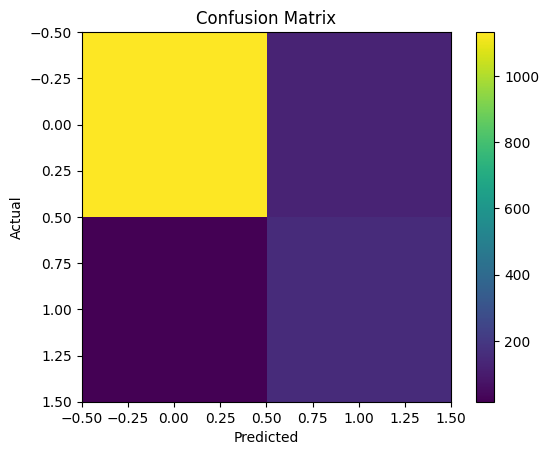


Clusters Found: {0.0, -1.0}

Vaccination Centers:


,Latitude,Longitude,Active
0,17.009452,76.879877,1
1,24.930002,81.107336,1
2,16.150721,75.633877,1
3,23.287848,93.189960,1
4,11.449609,69.523569,1
5,18.705214,77.134345,1
6,11.292893,95.953720,1
7,26.404957,76.662003,1
8,22.581685,72.763416,1
9,20.157396,91.799896,1



Full Dataset Preview (First 20 Rows):


,shapeName,Latitude,Longitude,Coverage,Risk,PovertyIndex,LiteracyRate,Rurality,Cluster
0,Pratappur,23.535849,83.109415,87.72,0,0.190,83.86,0,-1.0
1,Pali,22.419377,82.343170,65.58,1,0.446,63.87,0,0.0
2,Pali,22.419377,82.343170,65.58,1,0.446,63.87,0,0.0
3,Lailunga,22.354272,83.592371,88.33,0,0.174,87.80,0,-1.0
4,Bilaigarh,21.615691,82.801042,85.34,0,0.044,85.53,0,-1.0
5,Dharamjaigarh,22.465222,83.235396,82.08,0,0.094,79.23,1,-1.0
6,Balrampur,23.560771,83.550149,78.65,0,0.253,78.41,1,0.0
7,Wadrafnagar,23.780995,83.118763,82.95,0,0.133,78.46,1,-1.0
8,Gharghoda,22.231306,83.334304,78.75,0,0.334,80.02,0,-1.0
9,Kota,22.419567,82.031220,75.19,0,0.221,75.98,1,-1.0



Showing 20 of 7262 rows


,shapeName,Latitude,Longitude,Coverage,Risk,PovertyIndex,LiteracyRate,Rurality,Cluster
0,Pratappur,23.535849,83.109415,87.72,0,0.190,83.86,0,-1.0
1,Pali,22.419377,82.343170,65.58,1,0.446,63.87,0,0.0
2,Pali,22.419377,82.343170,65.58,1,0.446,63.87,0,0.0
3,Lailunga,22.354272,83.592371,88.33,0,0.174,87.80,0,-1.0
4,Bilaigarh,21.615691,82.801042,85.34,0,0.044,85.53,0,-1.0
...,...,...,...,...,...,...,...,...,...
7257,Alwal,17.526263,78.517223,74.30,1,0.293,74.90,0,0.0
7258,Balanagar,17.469872,78.461673,88.78,0,0.050,90.67,1,-1.0
7259,Kukatpally,17.485988,78.411229,74.76,1,0.224,73.68,0,0.0
7260,Warangal,18.010254,79.623375,82.83,0,0.220,87.26,1,-1.0


In [24]:
# ==========================================
# 1. IMPORT LIBRARIES
# ==========================================
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import HeatMap
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from xgboost import XGBClassifier
from scipy.spatial import cKDTree
import matplotlib.pyplot as plt
from IPython.display import display, HTML

pd.set_option('display.max_rows', 50)

# ==========================================
# 2. LOAD GEO DATA
# ==========================================
india = gpd.read_file("/content/drive/MyDrive/GIS/india_India_Country_Boundary.geojson").to_crs(4326)
regions = gpd.read_file("/content/drive/MyDrive/GIS/geoBoundaries-IND-ADM4_simplified.geojson").to_crs(4326)

print("India Boundary Loaded")
print("ADM4 Regions Loaded:", len(regions))   # ~7143 expected

# ==========================================
# 3. CENTROIDS (ACCURATE)
# ==========================================
regions_proj = regions.to_crs(3857)
centroids = regions_proj.centroid.to_crs(4326)

regions["Latitude"] = centroids.y
regions["Longitude"] = centroids.x

# ==========================================
# 4. COVERAGE MODEL
# ==========================================
regions["Coverage"] = np.clip(
    np.random.normal(82, 6, len(regions)),
    60, 100
)

regions["Risk"] = (regions["Coverage"] < 75).astype(int)

print("Low Coverage Regions:", regions["Risk"].sum())

# ==========================================
# 5. FEATURES FOR ML
# ==========================================
regions["PovertyIndex"] = np.clip(
    1 - regions["Coverage"]/100 + np.random.normal(0, 0.05, len(regions)),
    0, 1
)

regions["LiteracyRate"] = np.clip(
    regions["Coverage"] + np.random.normal(0, 3, len(regions)),
    40, 100
)

regions["Rurality"] = np.random.choice([0, 1], len(regions))

X = regions[["PovertyIndex", "LiteracyRate", "Rurality"]]
y = regions["Risk"]

# ==========================================
# 6. TRAIN TEST SPLIT
# ==========================================
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

ratio = (len(y) - y.sum()) / y.sum()

# ==========================================
# 7. TRAIN XGBOOST
# ==========================================
model = XGBClassifier(
    n_estimators=120,
    max_depth=5,
    learning_rate=0.08,
    scale_pos_weight=ratio,
    eval_metric="logloss"
)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# ==========================================
# 8. PERFORMANCE METRICS
# ==========================================
acc = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, output_dict=True, zero_division=0)
cm = confusion_matrix(y_test, y_pred)

performance_table = pd.DataFrame(report).transpose()

print("\nAccuracy Score:", acc)

print("\nClassification Report:")
display(performance_table)

print("\nConfusion Matrix:")
print(cm)

# ==========================================
# 9. CONFUSION MATRIX PLOT
# ==========================================
plt.figure()
plt.imshow(cm)
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.colorbar()
plt.show()

# ==========================================
# 10. COLD SPOT CLUSTERING
# ==========================================
low_cov = regions[regions["Risk"] == 1].copy()

if len(low_cov) > 0:
    coords_scaled = StandardScaler().fit_transform(
        low_cov[["Latitude", "Longitude"]]
    )

    dbscan = DBSCAN(eps=0.3, min_samples=6)
    low_cov["Cluster"] = dbscan.fit_predict(coords_scaled)

    regions = regions.merge(
        low_cov[["shapeName", "Cluster"]],
        on="shapeName",
        how="left"
    )

regions["Cluster"] = regions["Cluster"].fillna(-1)

print("\nClusters Found:", set(regions["Cluster"]))

# ==========================================
# 11. VACCINATION CENTERS
# ==========================================
centers = pd.DataFrame({
    "Latitude": np.random.uniform(8, 35, 20),
    "Longitude": np.random.uniform(68, 97, 20),
    "Active": np.random.choice([0,1], 20, p=[0.2, 0.8])
})

tree = cKDTree(centers[["Latitude", "Longitude"]])

def nearest_center(lat, lon):
    dist, idx = tree.query([lat, lon])
    return centers.iloc[idx]

print("\nVaccination Centers:")
display(centers)

# ==========================================
# 12. DATASET TABLE (SMART PREVIEW)
# ==========================================
table_df = regions[[
    "shapeName","Latitude","Longitude","Coverage",
    "Risk","PovertyIndex","LiteracyRate","Rurality","Cluster"
]].copy()

table_df = table_df.round({
    "Latitude": 6,
    "Longitude": 6,
    "Coverage": 2,
    "PovertyIndex": 3,
    "LiteracyRate": 2
})

print("\nFull Dataset Preview (First 20 Rows):")
display(table_df.head(20))

print(f"\nShowing 20 of {len(table_df)} rows")

# Expand toggle
HTML("""
<button onclick="
var x=document.getElementById('fulltbl');
if(x.style.display==='none'){x.style.display='block'}
else{x.style.display='none'}">
Toggle Full Dataset
</button>
""")

display(HTML('<div id="fulltbl" style="display:none">'))
display(table_df)
display(HTML('</div>'))

# ==========================================
# 13. MAP (OPTIMIZED)
# ==========================================
viz_regions = regions.sample(2500, random_state=42)  # prevents lag
viz_json = viz_regions.to_json()

m = folium.Map(location=[22.5, 80.9], zoom_start=5)

folium.GeoJson(india, name="India Boundary").add_to(m)

folium.Choropleth(
    geo_data=viz_json,
    data=viz_regions,
    columns=["shapeName", "Coverage"],
    key_on="feature.properties.shapeName",
    fill_color="YlOrRd",
    name="Coverage Choropleth"
).add_to(m)

# Centers Layer
centers_layer = folium.FeatureGroup(name="Vaccination Centers", show=False)
for _, c in centers.iterrows():
    folium.Marker(
        [c["Latitude"], c["Longitude"]],
        icon=folium.Icon(color="green" if c["Active"] else "red")
    ).add_to(centers_layer)
centers_layer.add_to(m)

# Routes Layer
routes_layer = folium.FeatureGroup(name="Shortest Routes", show=False)
for _, r in viz_regions[viz_regions["Cluster"] != -1].iterrows():
    c = nearest_center(r["Latitude"], r["Longitude"])
    if c["Active"]:
        folium.PolyLine([
            [r["Latitude"], r["Longitude"]],
            [c["Latitude"], c["Longitude"]]
        ], weight=1).add_to(routes_layer)
routes_layer.add_to(m)

# Cluster Layer
cluster_layer = folium.FeatureGroup(name="Cold Spot Clusters", show=True)
for _, r in viz_regions[viz_regions["Cluster"] != -1].iterrows():
    folium.CircleMarker(
        [r["Latitude"], r["Longitude"]],
        radius=4,
        color="blue"
    ).add_to(cluster_layer)
cluster_layer.add_to(m)

# Heatmap Layer
heat_layer = folium.FeatureGroup(name="Risk Heatmap", show=False)
HeatMap(
    viz_regions[viz_regions["Risk"] == 1][["Latitude","Longitude"]]
    .values.tolist()
).add_to(heat_layer)
heat_layer.add_to(m)

folium.LayerControl().add_to(m)

m


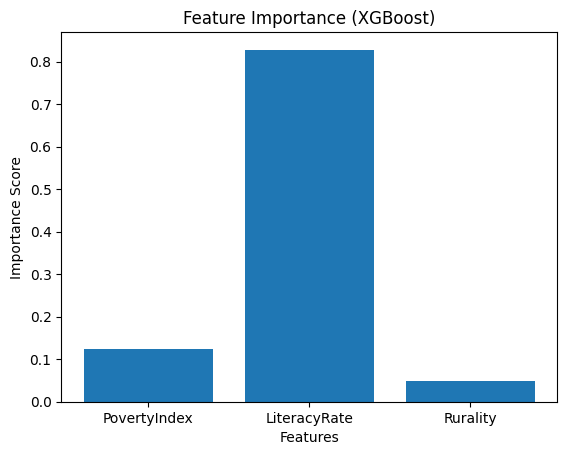

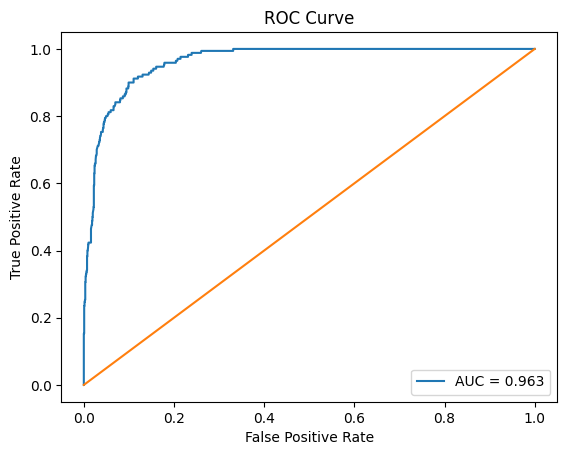

In [25]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# --- Feature Importance ---
importance = model.feature_importances_
features = X.columns

plt.figure()
plt.bar(features, importance)
plt.title("Feature Importance (XGBoost)")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.show()


# --- ROC Curve ---
y_prob = model.predict_proba(X_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.3f}")
plt.plot([0, 1], [0, 1])
plt.title("ROC Curve")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.show()
